In [85]:
import numpy as np
from matplotlib import pyplot as plt
from opt_utils_v1a import relu, sigmoid , load_dataset , compute_cost
import math


%matplotlib inline
plt.rcParams['figure.figsize'] = (7.0, 4.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

In [86]:
def standardize(input , epsilon = 1e-8):

    batch_m = input.shape[1]
    mean = np.sum(input, axis = 1, keepdims = True)* (1./batch_m)
    # variance = np.linalg.norm(input - mean, axis = 1, keepdims = True)/math.sqrt(batch_m)

    variance = np.sum(np.square(input - mean) , axis = 1 , keepdims = True)*(1./batch_m)

    std = np.sqrt(variance)

    standardized_input = np.divide(input - mean , std+epsilon)

    assert (mean.shape == (input.shape[0], 1))
    assert (variance.shape == (input.shape[0],1))
    assert (standardized_input.shape == input.shape)

    return mean , variance, standardized_input


In [108]:
def scale(input , beta , gamma):
    # print(input.shape)
    # print(beta.shape)
    # print(gamma.shape)

    assert(input.shape[0] == beta.shape[0])
    assert(input.shape[0] == gamma.shape[0])

    scaled_input = np.multiply(input , gamma) + beta


    assert(scaled_input.shape == input.shape)
    return scaled_input
    

In [88]:
def random_mini_batches(X ,Y ,   batch_size = 64, seed = 0):



    m = X.shape[1]

    iterations = m//batch_size

    c = True
    while c:
        np.random.seed(seed)
        seed +=1

    # X = X.T
    # np.random.shuffle(X)
    # shuffled_X = X.T
    # np.random.seed(seed)
    # Y = Y.T
    # np.random.shuffle(Y)
    # shuffled_Y = Y.T

        permutation = list(np.random.permutation(m))
        shuffled_X = X[:, permutation]
        shuffled_Y = Y[:, permutation].reshape((1,m))
        
    # elif method == "constant":
    #     shuffled_X = X
    #     shuffled_Y = Y

        for i in range(iterations):
            mini_x = shuffled_X[: , batch_size*i : (i+1)*batch_size]
            mini_y  = shuffled_Y[: , batch_size*i : (i+1)*batch_size]
            yield mini_x, mini_y
            
        remaining = m%batch_size
        assert((remaining  + iterations*batch_size) == m)
        mini_x  = shuffled_X[: , -remaining:]
        mini_y = shuffled_Y[: , -remaining:]
        yield mini_x, mini_y





In [89]:
def initialize_parameters(layer_dims):

    
    np.random.seed(3)
    parameters = {}
    L = len(layer_dims) # number of layers in the network

    for l in range(1, L):
        parameters['W' + str(l)] = np.random.randn(layer_dims[l], layer_dims[l-1])*  np.sqrt(2 / layer_dims[l-1])
        parameters['b' + str(l)] = np.zeros((layer_dims[l], 1))
        
        assert parameters['W' + str(l)].shape[0] == layer_dims[l], layer_dims[l-1]
        assert parameters['W' + str(l)].shape[0] == layer_dims[l], 1
        
    return parameters

In [90]:
def initialize_batch_normalization(layer_dims):
    scaling_parameters = {}

    L = len(layer_dims)
    for l in range(1, L-1):
        scaling_parameters['beta' + str(l)] = np.zeros((layer_dims[l],1))
        scaling_parameters['gamma' + str(l)] = np.ones((layer_dims[l], 1))
        
        assert scaling_parameters['beta' + str(l)].shape == (layer_dims[l],1)
        assert scaling_parameters['gamma' + str(l)].shape == (layer_dims[l], 1)
        
    return scaling_parameters

In [91]:
def forward_propagation(X, parameters, scaling_parameters):

    # moving_average = {}


    beta1 = scaling_parameters["beta1"]
    beta2 = scaling_parameters["beta2"]
    gamma1= scaling_parameters["gamma1"]
    gamma2 = scaling_parameters["gamma2"]

    L = len(parameters)//2
    # retrieve parameters
    W1 = parameters["W1"]
    b1 = parameters["b1"]
    W2 = parameters["W2"]
    b2 = parameters["b2"]
    W3 = parameters["W3"]
    b3 = parameters["b3"]
    
    # LINEAR -> RELU -> LINEAR -> RELU -> LINEAR -> SIGMOID
    z1 = np.dot(W1, X)
    mean_z1 , variance_z1 , standard_z1   = standardize(z1)
    scaled_z1 = scale(standard_z1 , beta1 , gamma1)
    a1 = relu(scaled_z1)

    z2 = np.dot(W2, a1) 
    mean_z2 , variance_z2, standard_z2 = standardize(z2)
    scaled_z2 = scale(standard_z2, beta2, gamma2)
    a2 = relu(scaled_z2)

    z3 = np.dot(W3, a2) + b3
    a3 = sigmoid(z3)
    
    cache = (z1, a1, W1, z2, a2, W2, z3, a3, W3, b3 , standard_z1 , standard_z2 , mean_z1 , mean_z2 , variance_z1 , variance_z2, gamma1, gamma2)
    # moving_average["mean_z2"] = mean_z2
    # moving_average["mean_z1"] = mean_z1
    # moving_average["variance_z1"] = variance_z1
    # moving_average["variance_z2"] = variance_z2

    
    return a3, cache 

In [92]:
def update_moving_parameters(global_average , moving_average , momentum = 0.9):

    L = len(global_average)

    for i in range(L):
        global_average["mean_z"+str(i+1)] = momentum * global_average["mean_z"+str(i+1)] + (1 - momentum)* moving_average["mean_z"+str(i+1)]
        global_average["variance_z"+str(i+1)] = momentum * global_average["variance_z"+str(i+1)] + (1 - momentum)* moving_average["variance_z"+str(i+1)]
        
    return global_average

In [93]:
def backward_batch_normalization(x, dy, xhat ,mean, variance , gamma , epsilon = 1e-8):
    m = x.shape[1]

    dxhat = np.multiply(dy , gamma)

    dvariance  = np.sum(dxhat * (x - mean) * ((-1./2)*np.power((variance + epsilon) , -3/2)) , axis = 1 , keepdims = True)

    dmean  = np.sum(dxhat * -1 * np.power((variance + epsilon) , -1/2) , axis = 1 , keepdims = True) + (np.sum((x - mean) , axis = 1 , keepdims = True)*(-2./m) * dvariance)

    dx = np.multiply( dxhat ,  np.power(variance + epsilon , -1/2)) + (dvariance * (2./m) * (x - mean)) + (dmean * (1./m))

    dgamma = np.sum(dy * xhat  , axis = 1, keepdims = True)
    dbeta = np.sum(dy)

    return dx, dgamma, dbeta
                                                                                                

In [94]:
def backward_propagation(X, Y, cache):

    m = X.shape[1]
    (z1, a1, W1, z2, a2, W2, z3, a3, W3, b3 , standard_z1 , standard_z2 , mean_z1 , mean_z2 , variance_z1 , variance_z2, gamma1, gamma2) = cache
    
    dz3 = 1./m * (a3 - Y)
    dW3 = np.dot(dz3, a2.T)
    db3 = np.sum(dz3, axis=1, keepdims = True)
    
    da2 = np.dot(W3.T, dz3)
    dy2 = np.multiply(da2, np.int64(a2 > 0))
    dz2 , dgamma2, dbeta2 = backward_batch_normalization(z2, dy2 , standard_z2 , mean_z2 , variance_z2 , gamma2)

    
    dW2 = np.dot(dz2, a1.T)


    da1 = np.dot(W2.T, dz2)
    dy1 = np.multiply(da1, np.int64(a1 > 0))
    dz1, dgamma1, dbeta1, = backward_batch_normalization(z1, dy1, standard_z1 , mean_z1 , variance_z1, gamma1)
    dW1 = np.dot(dz1, X.T)

    
    gradients = {"dz3": dz3, "dW3": dW3, "db3": db3,
                 "da2": da2, "dz2": dz2, "dW2": dW2, 
                 "da1": da1, "dz1": dz1, "dW1": dW1, 
                 "dgamma1" : dgamma1 , "dgamma2": dgamma2,
                 "dbeta1" : dbeta1 , "dbeta2": dbeta2}
    
    return gradients


In [105]:
def update_parameters_with_gd(parameters,scaling_parameters ,  grads, learning_rate):
    L = int(len(parameters.keys())/2)

    for i in range(L):
        parameters['W'+str(i+1)] = parameters['W'+ str(i+1)] - learning_rate*grads["dW" + str(i+1)]
        if i+1 == L:
            parameters['b' + str(i+1)] = parameters['b'+ str(i+1)] - learning_rate*grads["db"+ str(i+1)]
        else:
            scaling_parameters["beta"+str(i+1)] = scaling_parameters["beta"+str(i+1)] - learning_rate*grads["dbeta"+str(i+1)]
            scaling_parameters["gamma"+str(i+1)] = scaling_parameters["gamma"+str(i+1)] - learning_rate*grads["dgamma"+str(i+1)]
    
    return parameters , scaling_parameters

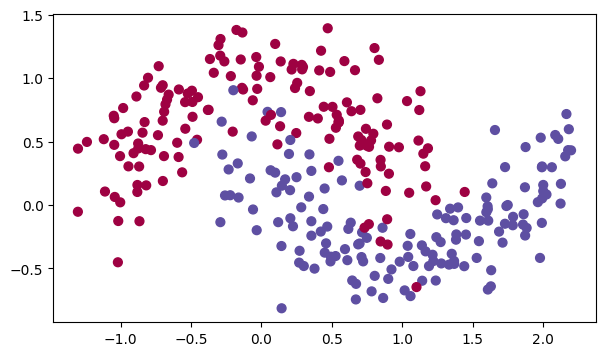

In [96]:
train_X, train_Y = load_dataset()

In [102]:
import gc
def model(X, Y, layers_dims, learning_rate = 0.0007, mini_batch_size = 64, beta = 0.9, beta1 = 0.9, beta2 = 0.999,  epsilon = 1e-8, num_epochs = 10000, print_cost = True):


    L = len(layers_dims)             # number of layers in the neural networks
    costs = []                       # to keep track of the cost
    t = 0                            # initializing the counter required for Adam update
    seed = 10                        # For grading purposes, so that your "random" minibatches are the same as ours
    m = X.shape[1]                   # number of training examples
    print("\nThe number of training examples is : %i\n" %m)
    print("The mini-batch size : %i\n" %mini_batch_size)
    # Initialize parameters
    parameters = initialize_parameters(layers_dims)
    scaling_parameters = initialize_batch_normalization(layers_dims)


    # if optimizer == "gd":
    #     pass
    # elif optimizer == "momentum":
    #     v = initialize_velocity(parameters)
    # elif optimizer == "rmsprop":
    #     s = initialize_rmsprop(parameters)
    # elif optimizer == "adam":
    #     v,s = initialize_adam(parameters)
    
    
    minibatches = random_mini_batches(X, Y, mini_batch_size, seed)

    for l in range(num_epochs):
    

        cost_total = 0
        
        for i in range(m//mini_batch_size + 1):

            mini_x, mini_y  =  next(minibatches)
            # Select a minibatch

            # Forward propagation
            a3, caches = forward_propagation(mini_x, parameters, scaling_parameters)

            # Compute cost and add to the cost total
            cost_total = cost_total +  compute_cost(a3, mini_y)
            print("\n OK OK \n")
            print("mini_y: " , mini_y)
            # print("costs : ", cost_total)
            print("\n OK OK \n")

            # Backward propagation
            grads = backward_propagation(mini_x, mini_y, caches)
            parameters , scaling_parameters= update_parameters_with_gd(parameters, scaling_parameters, grads, learning_rate)

            # Update parameters
            # if optimizer == "gd":
            #     parameters = update_parameters_with_gd(parameters, grads, learning_rate)
            # elif optimizer == "momentum":
            #     parameters, v = update_parameters_with_momentum(parameters, grads, v, beta, learning_rate)
            # elif optimizer == "rmsprop":
            #     parameters, s = update_parameters_with_rmsprop(parameters, grads, s, beta2, learning_rate, epsilon)
            # elif optimizer == "adam":
            #     t = t + 1 # Adam counter
            #     parameters, v, s = update_parameters_with_adam(parameters, grads, v, s,
            #                                                    t, learning_rate, beta1, beta2,  epsilon)
        cost_avg = cost_total / m

        # costs.append(cost_avg)
        # Print the cost every 1000 epoch
        if print_cost and l % 1000 == 0:
            print ("Cost after epoch %i: %f" %(i, cost_avg))         
        if (l % 100) == 0:
            costs.append(cost_avg)


    del minibatches
    gc.collect()         
    print("costs after %i "%(num_epochs) , costs)      
    # # plot the cost
    plt.plot(costs)
    plt.ylabel('cost')
    plt.xlabel('epochs (per 100)')
    plt.title("Learning rate = " + str(learning_rate))
    plt.show()

    return parameters, scaling_parameters

    

In [103]:
def predict(X, y, parameters, scaling_parameters):

    
    m = X.shape[1]
    p = np.zeros((1,m), dtype = np.int64)

    a3, caches = forward_propagation(X, parameters , scaling_parameters)
    
    # convert probas to 0/1 predictions
    for i in range(0, a3.shape[1]):
        if a3[0,i] > 0.5:
            p[0,i] = 1
        else:
            p[0,i] = 0


    print("Accuracy: "  + str(np.mean((p[0,:] == y[0,:]))))
    
    return p


The number of training examples is : 300

The mini-batch size : 64


 OK OK 

mini_y:  [[1 0 0 0 1 0 0 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 1 1 1 0 0 1 1 0 0 1 1 1 1 1
  0 0 0 1 0 1 0 1 0 0 1 0 1 0 0 0 1 1 0 1 1 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

mini_y:  [[0 0 0 0 0 1 1 0 1 1 1 1 0 1 0 0 0 0 1 1 1 0 1 0 1 0 0 1 0 0 0 0 1 1 0 1
  1 0 0 0 0 1 0 0 0 0 1 0 0 1 1 1 1 1 0 1 1 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

mini_y:  [[0 0 1 0 0 1 1 1 1 1 1 1 1 0 0 1 1 0 1 1 1 0 0 1 1 1 0 0 1 1 1 1 0 0 0 1
  1 1 0 0 1 0 1 0 0 0 1 0 1 0 1 1 0 0 1 0 1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

mini_y:  [[1 1 1 0 1 1 1 1 0 0 1 1 1 0 0 0 1 0 0 0 0 1 0 1 0 1 1 1 0 0 0 1 0 1 1 1
  0 1 0 1 1 1 0 0 1 1 0 0 1 0 1 1 1 0 1 0 0 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

mini_y:  [[0 0 1 0 0 0 0 0 1 0 1 1 1 1 1 1 1 1 1 0 1 1 0 1 0 0 1 1 0 0 1 0 0 1 0 1
  1 0 0 1 0 0 1 1]]

 OK OK 

Cost after epoch 4: 0.899409

 OK OK 

mini_y:  [[1 0 1 0 1 1 0 0 1 0 1 1 0 0 1 1 1 0 0 1 0 0 1 0 0 1 0 0 0 1 0 0 1 0 0 1
  1 1 0 1 0 1 1 1 1 0 1 0 1 0 1 0 

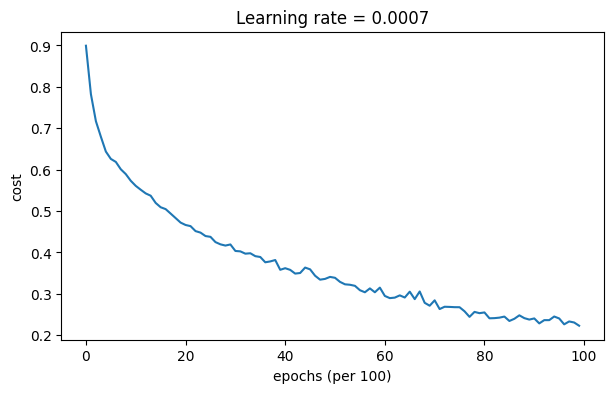

Accuracy: 0.94


In [110]:
layers_dims = [train_X.shape[0], 5, 2, 1]
parameters , scaling_parameters = model(train_X, train_Y, layers_dims, learning_rate = 0.0007)

# # Predict
predictions = predict(train_X, train_Y, parameters , scaling_parameters)

In [ ]:
print(train_X.shape)
print(train_Y.shape)

In [111]:
def initialize_adam(parameters , scaling_parameters):

    s ={}
    v = {}
    L = len(parameters)//2

    for i in range(L):
        s["dW" + str(i+1)]  = np.zeros((parameters['W'+ str(i+1)].shape[0] , parameters['W'+ str(i+1)].shape[1]))


        if i+1 ==L : 
            s["db" + str(i+1)] = np.zeros((parameters['b' + str(i+1)].shape[0],  parameters['b'+str(i+1)].shape[1]))

        else:
            s["dbeta" + str(i+1)] = np.zeros((scaling_parameters['beta' + str(i+1)].shape[0],  scaling_parameters['beta'+str(i+1)].shape[1]))
            s["dgamma" + str(i+1)] = np.zeros((scaling_parameters['gamma' + str(i+1)].shape[0],  scaling_parameters['gamma'+str(i+1)].shape[1]))
        

        v["dW" + str(i+1)]  = np.zeros((parameters['W'+ str(i+1)].shape[0] , parameters['W'+ str(i+1)].shape[1]))

        if i+1 ==L : 
            v["db" + str(i+1)] = np.zeros((parameters['b' + str(i+1)].shape[0],  parameters['b'+str(i+1)].shape[1]))
            
        else:
            v["dbeta" + str(i+1)] = np.zeros((scaling_parameters['beta' + str(i+1)].shape[0],  scaling_parameters['beta'+str(i+1)].shape[1]))
            v["dgamma" + str(i+1)] = np.zeros((scaling_parameters['gamma' + str(i+1)].shape[0],  scaling_parameters['gamma'+str(i+1)].shape[1]))
    
    return v, s
    


In [112]:

def update_parameters_with_adam(parameters,scaling_parameters, grads, v, s, t, learning_rate = 0.01, beta1 = 0.9, beta2 = 0.999,  epsilon = 1e-8):
    L = len(parameters)//2
    v_corrected = {}
    s_corrected = {}

    for i in range(L):
        s["dW"+str(i+1)] = beta2*s["dW"+str(i+1)] + (1-beta2)*np.square(grads["dW"+str(i+1)])

        if i+1 == L:
            s["db"+str(i+1)] = beta2*s["db"+str(i+1)] + (1-beta2)*np.square(grads["db"+str(i+1)])
        
        else :
            s["dbeta"+str(i+1)] = beta2*s["dbeta"+str(i+1)] + (1-beta2)*np.square(grads["dbeta"+str(i+1)])
            s["dgamma"+str(i+1)] = beta2*s["dgamma"+str(i+1)] + (1-beta2)*np.square(grads["dgamma"+str(i+1)])




        v["dW"+str(i+1)] = beta1*v["dW"+str(i+1)] + (1-beta1)*grads["dW"+str(i+1)]

        if i+1 == L:
            v["db"+str(i+1)] = beta1*v["db"+str(i+1)] + (1-beta1)*grads["db"+str(i+1)]

        else:
            v["dbeta"+str(i+1)] = beta1*v["dbeta"+str(i+1)] + (1-beta1)*grads["dbeta"+str(i+1)]
            v["dgamma"+str(i+1)] = beta1*v["dgamma"+str(i+1)] + (1-beta1)*grads["dgamma"+str(i+1)]


        v_corrected["dW" + str(i+1)] = v["dW" + str(i+1)]/(1 - beta1**t)

        if i+1 == L:
            v_corrected["db" + str(i+1)] = v["db" + str(i+1)]/(1 - beta1**t)

        else : 
            v_corrected["dbeta" + str(i+1)] = v["dbeta" + str(i+1)]/(1 - beta1**t)           
            v_corrected["dgamma" + str(i+1)] = v["dgamma" + str(i+1)]/(1 - beta1**t)           

        s_corrected["dW" + str(i+1)] = s["dW" + str(i+1)]/(1 - beta2**t)

        if i+1 == L:
            s_corrected["db" + str(i+1)] = s["db" + str(i+1)]/(1 - beta2**t)
        
        else:
            s_corrected["dbeta" + str(i+1)] = s["dbeta" + str(i+1)]/(1 - beta2**t)
            s_corrected["dgamma" + str(i+1)] = s["dgamma" + str(i+1)]/(1 - beta2**t)


        parameters['W'+str(i+1)] = parameters['W'+str(i+1)] -   learning_rate*np.divide(v_corrected["dW"+str(i+1)],np.sqrt(s_corrected["dW"+str(i+1)]) + epsilon)

        if i+1 ==L:
            parameters['b'+str(i+1)] = parameters['b' + str(i+1)] - learning_rate*np.divide(v_corrected["db"+str(i+1)],np.sqrt(s_corrected["db"+str(i+1)]) + epsilon)
        
        else:
            scaling_parameters['beta'+str(i+1)] = scaling_parameters['beta' + str(i+1)] - learning_rate*np.divide(v_corrected["dbeta"+str(i+1)],np.sqrt(s_corrected["dbeta"+str(i+1)]) + epsilon)
            scaling_parameters['gamma'+str(i+1)] = scaling_parameters['gamma' + str(i+1)] - learning_rate*np.divide(v_corrected["dgamma"+str(i+1)],np.sqrt(s_corrected["dgamma"+str(i+1)]) + epsilon)


    return parameters, scaling_parameters, v, s



In [115]:
import gc
def optimizer_model(X, Y, layers_dims, optimizer, learning_rate = 0.0007, mini_batch_size = 64, beta = 0.9, beta1 = 0.9, beta2 = 0.999,  epsilon = 1e-8, num_epochs = 10000, print_cost = True):


    L = len(layers_dims)             # number of layers in the neural networks
    costs = []                       # to keep track of the cost
    t = 0                            # initializing the counter required for Adam update
    seed = 10                        # For grading purposes, so that your "random" minibatches are the same as ours
    m = X.shape[1]                   # number of training examples
    print("\nThe number of training examples is : %i\n" %m)
    print("The mini-batch size : %i\n" %mini_batch_size)
    # Initialize parameters
    parameters = initialize_parameters(layers_dims)
    scaling_parameters = initialize_batch_normalization(layers_dims)


    if optimizer == "gd":
        pass
    # elif optimizer == "momentum":
    #     v = initialize_velocity(parameters)
    # elif optimizer == "rmsprop":
    #     s = initialize_rmsprop(parameters)
    elif optimizer == "adam":
        v,s = initialize_adam(parameters , scaling_parameters)
    
    
    minibatches = random_mini_batches(X, Y, mini_batch_size, seed)

    for l in range(num_epochs):
    

        cost_total = 0
        
        for i in range(m//mini_batch_size + 1):

            mini_x, mini_y  =  next(minibatches)
            # Select a minibatch

            # Forward propagation
            a3, caches = forward_propagation(mini_x, parameters, scaling_parameters)

            # Compute cost and add to the cost total
            cost_total = cost_total +  compute_cost(a3, mini_y)
            print("\n OK OK \n")
            print("mini_y: " , mini_y)
            # print("costs : ", cost_total)
            print("\n OK OK \n")

            # Backward propagation
            grads = backward_propagation(mini_x, mini_y, caches)
            # parameters , scaling_parameters= update_parameters_with_gd(parameters, scaling_parameters, grads, learning_rate)

            # Update parameters
            if optimizer == "gd":
                parameters , scaling_parameters= update_parameters_with_gd(parameters, scaling_parameters, grads, learning_rate)
            # elif optimizer == "momentum":
            #     parameters, v = update_parameters_with_momentum(parameters, grads, v, beta, learning_rate)
            # elif optimizer == "rmsprop":
            #     parameters, s = update_parameters_with_rmsprop(parameters, grads, s, beta2, learning_rate, epsilon)
            elif optimizer == "adam":
                t = t + 1 # Adam counter
                parameters, scaling_parameters, v, s = update_parameters_with_adam(parameters,scaling_parameters,  grads, v, s,
                                                               t, learning_rate, beta1, beta2,  epsilon)
        cost_avg = cost_total / m

        # costs.append(cost_avg)
        # Print the cost every 1000 epoch
        if print_cost and l % 1000 == 0:
            print ("Cost after epoch %i: %f" %(i, cost_avg))         
        if (l % 100) == 0:
            costs.append(cost_avg)


    del minibatches
    gc.collect()         
    print("costs after %i "%(num_epochs) , costs)      
    # # plot the cost
    plt.plot(costs)
    plt.ylabel('cost')
    plt.xlabel('epochs (per 100)')
    plt.title("Learning rate = " + str(learning_rate))
    plt.show()

    return parameters, scaling_parameters

    


The number of training examples is : 300

The mini-batch size : 64


 OK OK 

mini_y:  [[1 0 0 0 1 0 0 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 1 1 1 0 0 1 1 0 0 1 1 1 1 1
  0 0 0 1 0 1 0 1 0 0 1 0 1 0 0 0 1 1 0 1 1 0 0 1 1 1 0 0]]

 OK OK 


 OK OK 

mini_y:  [[0 0 0 0 0 1 1 0 1 1 1 1 0 1 0 0 0 0 1 1 1 0 1 0 1 0 0 1 0 0 0 0 1 1 0 1
  1 0 0 0 0 1 0 0 0 0 1 0 0 1 1 1 1 1 0 1 1 1 0 1 1 0 0 1]]

 OK OK 


 OK OK 

mini_y:  [[0 0 1 0 0 1 1 1 1 1 1 1 1 0 0 1 1 0 1 1 1 0 0 1 1 1 0 0 1 1 1 1 0 0 0 1
  1 1 0 0 1 0 1 0 0 0 1 0 1 0 1 1 0 0 1 0 1 0 0 1 1 0 0 0]]

 OK OK 


 OK OK 

mini_y:  [[1 1 1 0 1 1 1 1 0 0 1 1 1 0 0 0 1 0 0 0 0 1 0 1 0 1 1 1 0 0 0 1 0 1 1 1
  0 1 0 1 1 1 0 0 1 1 0 0 1 0 1 1 1 0 1 0 0 0 0 0 0 0 1 1]]

 OK OK 


 OK OK 

mini_y:  [[0 0 1 0 0 0 0 0 1 0 1 1 1 1 1 1 1 1 1 0 1 1 0 1 0 0 1 1 0 0 1 0 0 1 0 1
  1 0 0 1 0 0 1 1]]

 OK OK 

Cost after epoch 4: 0.896004

 OK OK 

mini_y:  [[1 0 1 0 1 1 0 0 1 0 1 1 0 0 1 1 1 0 0 1 0 0 1 0 0 1 0 0 0 1 0 0 1 0 0 1
  1 1 0 1 0 1 1 1 1 0 1 0 1 0 1 0 

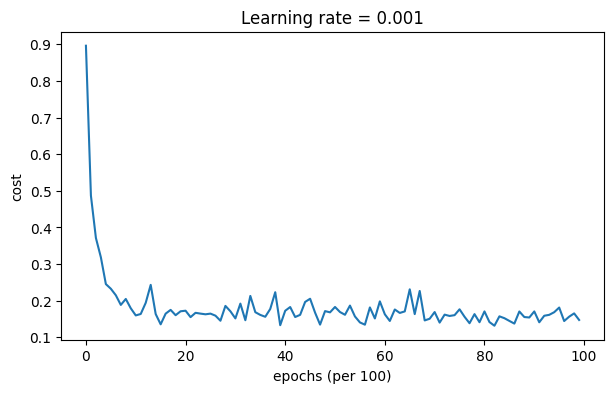

Accuracy: 0.9433333333333334


In [117]:
layers_dims = [train_X.shape[0], 5, 2, 1]
parameters , scaling_parameters = optimizer_model(train_X, train_Y,layers_dims,optimizer = "adam" , learning_rate = 0.001)

# # Predict
predictions = predict(train_X, train_Y, parameters , scaling_parameters)